# Lesson 1  Homework - Where's your city?

In [89]:
from fastai import *
from fastai.vision import *
import os
import random
from collections import defaultdict
import pandas as pd
import re
import umap
from sklearn.preprocessing import LabelEncoder
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
%matplotlib inline

In [2]:
torch.cuda.set_device(0)

In [3]:
path = Path('/home/henripal/projects/maps/scraper/')

In [4]:
path_img = path/'img'

In [91]:
data = ImageDataBunch.from_csv(path_img, ds_tfms=[], size=224, bs=64)
data.normalize(imagenet_stats)

In [92]:
learn = create_cnn(data, models.resnet50, metrics=error_rate)
learn.load('resnet50-big-finetuned-bs64')

In [93]:
layers = flatten_model(learn.model)

In [94]:
flatten_layer = layers[-8]

In [95]:
custom_hook = hook_output(flatten_layer)

In [96]:
final_layer_activations = []
names = []
for i, (x, y) in enumerate(learn.data.train_dl):
    learn.model(x)
    final_layer_activations.append(custom_hook.stored.cpu().numpy())
    names.append(y.cpu().numpy())
    if i > 16: break


In [97]:
activations = np.vstack(final_layer_activations)
names = np.hstack(names)

In [98]:
names.shape, activations.shape

((1152,), (1152, 4096))

In [99]:
umap = umap.UMAP()

In [100]:
U = umap.fit_transform(activations)

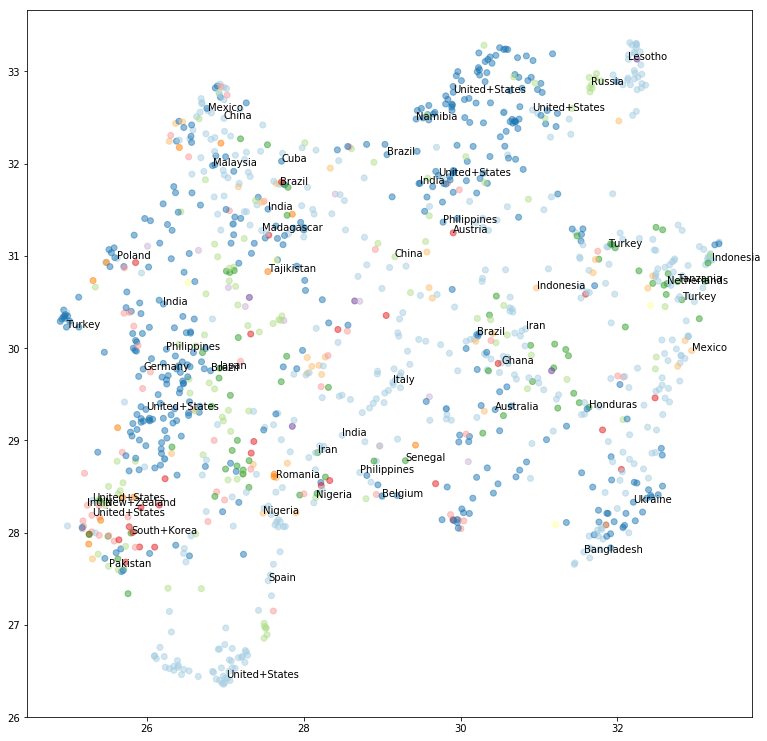

In [101]:
plt.figure(figsize=(13, 13))
plt.scatter(U[:,0], U[:,1], c=names, alpha=.5, cmap=plt.get_cmap("Paired"))
for i, name_idx in enumerate(names[::20]):
    plt.text(U[i, 0], U[i, 1], learn.data.classes[name_idx])

In [90]:
def visualize_scatter_with_images(X_2d_data, images, figsize=(45,45), image_zoom=1):
    fig, ax = plt.subplots(figsize=figsize)
    artists = []
    for xy, i in zip(X_2d_data, images):
        x0, y0 = xy
        img = OffsetImage(np.moveaxis(i.data.numpy(), 0, -1), zoom=image_zoom)
        ab = AnnotationBbox(img, (x0, y0), xycoords='data', frameon=False)
        artists.append(ax.add_artist(ab))
    ax.update_datalim(X_2d_data)
    ax.autoscale()
    plt.show()
    

In [125]:
images = []
for i in range(1000):
    img = open_image(learn.path/'train'/os.listdir('../scraper/img/train')[i])
    images.append(img) 

In [133]:
a = images[0]

In [142]:
a.data.numpy().shape

(3, 224, 224)

In [146]:
31*31

961

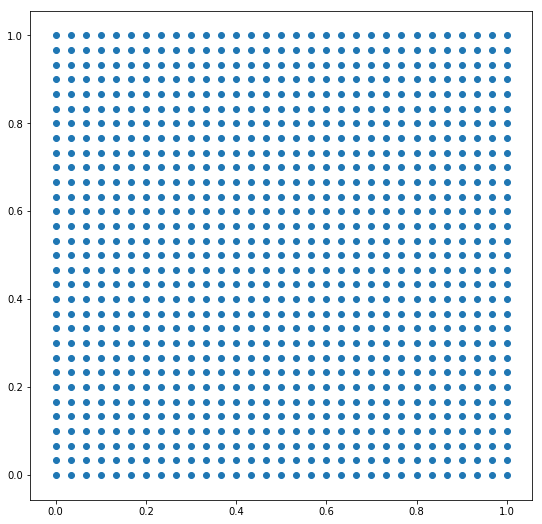

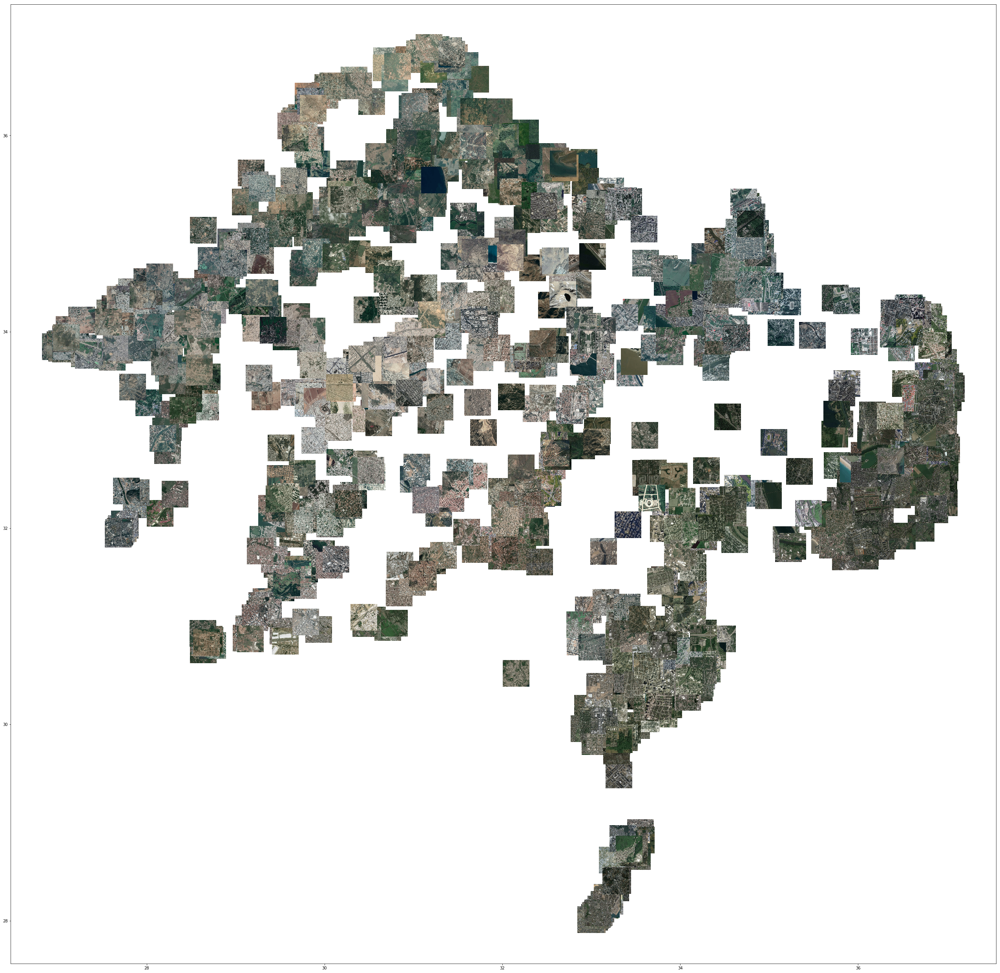

In [141]:
visualize_scatter_with_images(u, images, figsize=(45,45), image_zoom=.3)

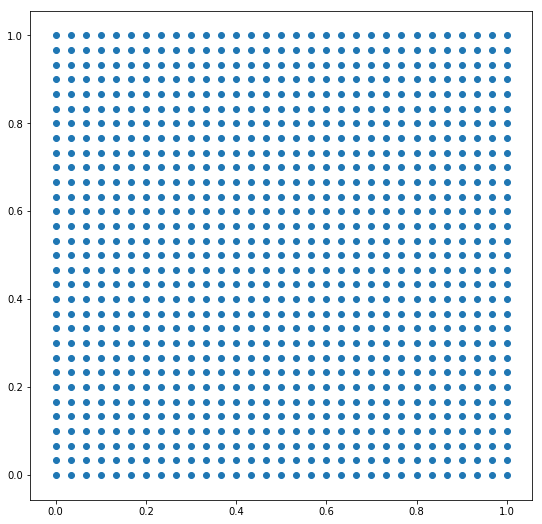

In [151]:
from scipy.spatial.distance import cdist
size = 31
grid = np.dstack(np.meshgrid(np.linspace(0, 1, size), np.linspace(0, 1, size))).reshape(-1, 2)
plt.rcParams["figure.figsize"] = (9, 9)
plt.scatter(grid[:,0], grid[:,1])

In [152]:
!pip install lapjv

  Running setup.py bdist_wheel for lapjv ... done
  Stored in directory: /home/henripal/.cache/pip/wheels/6e/fe/fd/b700bd67e00bcd65241d55d875eec17892a86ca6a4deef9515
Successfully built lapjv
fastai 1.0.18 requires jupyter, which is not installed.
fastai 1.0.18 requires torchvision-nightly, which is not installed.
distributed 1.19.1 requires msgpack-python, which is not installed.
spacy 2.0.16 has requirement regex==2018.01.10, but you'll have regex 2018.8.29 which is incompatible.
mxnet-cu91 1.1.0 has requirement numpy<=1.13.3, but you'll have numpy 1.15.2 which is incompatible.
mxnet-cu90 1.1.0 has requirement numpy<=1.13.3, but you'll have numpy 1.15.2 which is incompatible.
You are using pip version 10.0.1, however version 18.1 is available.
You should consider upgrading via the 'pip install --upgrade pip' command.


In [154]:
from lapjv import lapjv

In [160]:
cost_matrix = cdist(grid, u[:961], "sqeuclidean").astype(np.float32)
cost_matrix = cost_matrix * (100000 / cost_matrix.max())
%time row_asses, col_asses, _ = lapjv(cost_matrix)

CPU times: user 1.81 s, sys: 60.9 ms, total: 1.87 s
Wall time: 462 ms


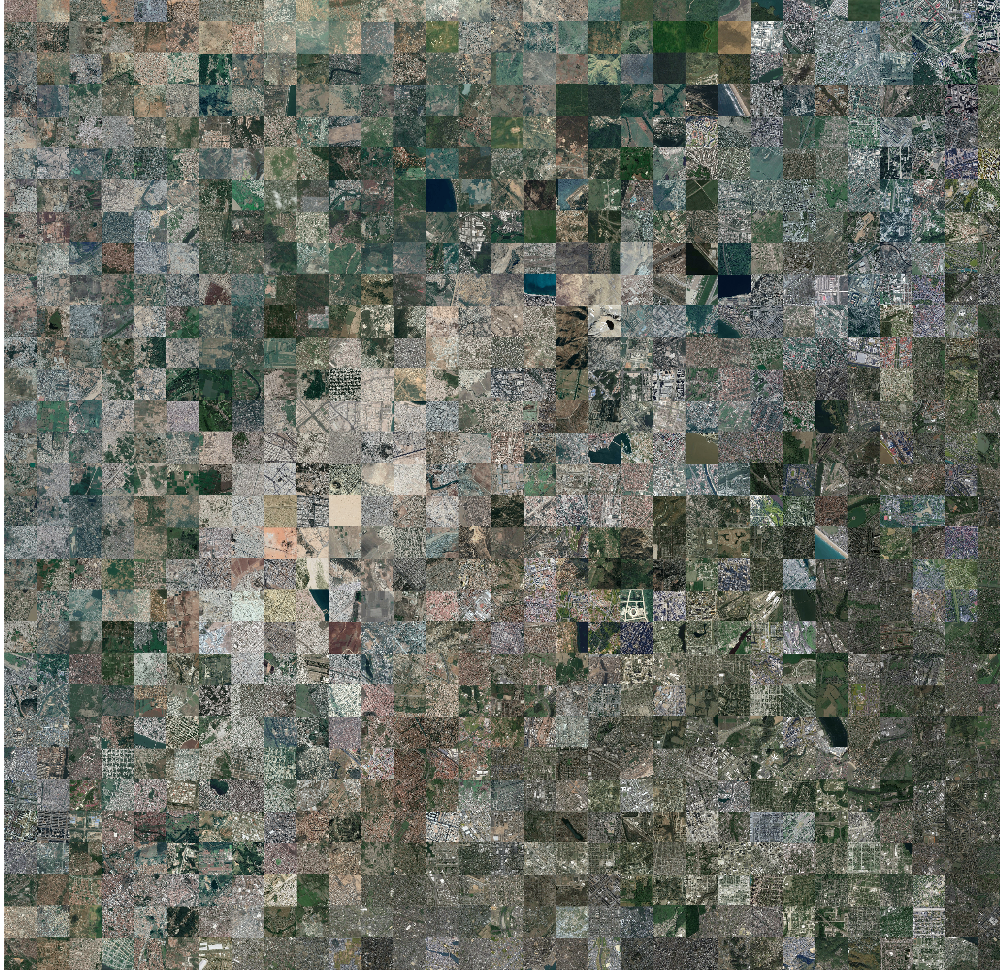

In [182]:
from PIL import Image

plt.rcParams["figure.figsize"] = (45, 45)
plt.gca().set_facecolor("black")
grid_jv = grid[col_asses]
for pos, img in zip(grid_jv, images):
    img = np.moveaxis(img.data.numpy(), 0, -1)
    #img = Image.fromarray(255 - img).resize((20, 20), Image.ANTIALIAS)
    ab = AnnotationBbox(OffsetImage(img, zoom=0.37),
                        pos * (size - 1) * 28, xycoords="data", frameon=False, box_alignment=(0, 0))
    plt.gca().add_artist(ab)
plt.xlim(0, (size - 1) * 28 + 16); plt.ylim(0, (size - 1) * 28 + 16)
plt.xticks([]); plt.yticks([])
plt.savefig('last.png')


In [183]:
2+2

4

In [184]:
learn.model

Sequential(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace)
        (downsample): Sequential(
          (0): Conv2d(64, 256, kernel_s